# Neural style

## Preliminary

* Covariance

$$Cov[X,Y]=E[XY]-E[X]E[Y]$$

* 이 때,

$$ Var[X]=Cov[X,X]=E[X\cdot X]-E[X]^2$$

* Correlation

$$Corr[XY] = \frac{Cov[XY]}{\sigma[X]\sigma[Y]}$$

* Here is **a key connection between linear algebra and probability theory:**
    * 만약 X, Y 가 평균이 0인 random variables 이라면, $Cov[XY]=E[X\cdot Y]$ 이 된다
    * 이는 X, Y 의 dot product (내적)
    * (왜?) stddev(X) = len(X) 이고, Corr[XY] = cosine(X, Y) 가 된다.
    * 즉, Corr > 0 이면 이 angle 이 날카로운거고, < 0 이면 큰거고, 0 이면 (uncorrelated) orthogonal 이다.

## Style transfer

### Content loss

* 네트워크의 higher layer feature 가 content 를 캡쳐함
* 너무 픽셀 하나하나를 reconstruction 하려고 하지 않으면서도 오브젝트들과 그 위치들을 가지고 있음
* 따라서 이를 content 로 정의하고 이를 보존

$$L_\text{content}(p,x,l)=\frac12 \sum_{i,j}(F^l_{ij}-P^l_{ij})^2$$

* P: features of content image p
* F: features of synthesis image x
* l: content layer
* 즉 synthesis image x 를 조정해서 F 를 P 에 가깝게 맞추자!

### Style loss

#### Gram matrix

* 모든 레이어에서의 필터 간 correlation => Gram matrix
* 그램 매트릭스는 location-invariant 하다 (이미지가 한칸씩 옆으로 이동해도 결과는 동일)
* 정확한 원리는 모르나 아무튼 이 그램 매트릭스가 위치정보는 버리고 텍스쳐 정보만 캡쳐한다
* multi-scale style 을 capture 하기 위해 모든 레이어의 피처를 다 사용한다 (논문의 fig. 1 참조)
    
$$ G^l_{ij}=\sum_k F^l_{ik}F^l_{jk} $$

#### Style loss

* Notations:
    * G: 그램 매트릭스
    * A: features of style image a
    * $N^l$: 레이어 l 의 필터 개수
    * $M^l$: 레이어 l 의 필터의 피처맵 크기 (height * width)


* 각 레이어의 로스:

$$E_l={1\over 4N^2_l M^2_l}\sum_{i,j}(G^l_{ij}-A^l_{ij})^2$$

* Total style loss:

$$L_\text{style}(a,x)=\sum^L_l w_lE_l$$

* $w_l$ 은 weighted sum 가중치
    * 논문에서는 전부 동일하게 1/5 (L=5) 로 두었음

### Total variation loss

* 논문에는 없으나 이미지에서 노이즈를 줄여주기 위해서 사용
* 말 그대로 이미지의 variation 을 total 한 것!
* spatial smoothness 제공
* 참조한 코드를 보면 x축, y축 기준으로 1픽셀씩 밀어서 L2 distance 를 계산해서 평균내어 더함

### Total style transfer loss

$$L_\text{total}=\alpha L_\text{content}(p,x) + \beta L_\text{style}(a,x) + \gamma L_\text{TV}(x)$$

* $\alpha / \beta$ ratio: $10^{-4}$ ~ $10^{-1}$ 로 다양하게 줄 수 있음
    * 논문의 실험결과는 대체로 $10^{-3}$ 근처를 사용
    * ratio 가 올라가면 content 비중이 커지는 것이므로 원본 이미지의 형태가 좀더 잘 보존되고,
    * 반대로 내려가면 style 비중이 커지는 것이므로 스타일이 더 잘 드러난다
* TV loss 는 원래 논문에는 나와있지 않으므로, $\gamma$ 또한 없음
* 적당히 주면 될 것 같음

## Implementation details

* Details
    * Style layers 는 전부 다 사용 (1-5)
    * Content layer 는 conv4_2 사용
    * $\alpha / \beta$ ratio 는 기본적으로 $10^{-3}$
    * optimizer 로 L-BFGS-B 사용
* Initialization
    * style/content 이미지 둘중 하나로
    * 혹은 여기에 + 로 noise 를 주면 실행할때마다 조금씩 다르게 이미지를 생성할 수 있음

In [1]:
import tensorflow as tf
import numpy as np
from VGG import VGG
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
CONTENT_LAYER = 'relu4_2'
STYLE_LAYERS = ['relu1_1', 'relu2_1', 'relu3_1', 'relu4_1', 'relu5_1']

# hyperparams
content_weight = 0.1
style_weight = 1
tv_weight = 0 # total variational denoising
learning_rate = 0.1

In [3]:
vgg = VGG()

In [4]:
CONTENT_PATH = 'data/Neckarfront_origin.jpg'
STYLE_PATH = 'data/der_schrei.jpg'

In [5]:
content = cv2.imread(CONTENT_PATH)
style = cv2.imread(STYLE_PATH)

In [6]:
class Image():
    @staticmethod
    def show_bgr(image):
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB));
    
    @staticmethod
    def crop(image):
        # resize to 256x256 / center crop if w/h ratio unbalanced
        h, w = image.shape[:2]
        if h > w:
            sth = (h-w)/2
            edh = h-sth
            image = image[sth:edh, :]
        else:
            stw = (w-h)/2
            edw = w-stw
            image = image[:, stw:edw]

        return image
    
    @staticmethod
    def resize(image, size=(256, 256)):
        return cv2.resize(image, size)
    
    @staticmethod
    def preproc(image):
        return Image.resize(Image.crop(image))

In [7]:
im = Image

In [8]:
content = im.preproc(content)
style = im.preproc(style)

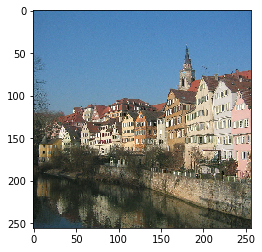

In [9]:
im.show_bgr(content)

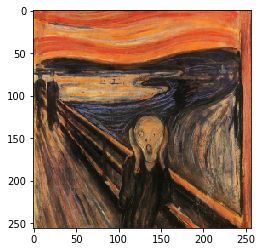

In [10]:
im.show_bgr(style)

## Progress ...

In [11]:
content.shape, style.shape

((256, 256, 3), (256, 256, 3))

In [12]:
content = content.astype(np.float)
content_shape = (1,) + content.shape # (h, w, nch) => (1, h, w, nch)
# nch = rgb?

# 여러개의 그래프를 생성하기 위해 이렇게 하는듯
with tf.Graph().as_default(), tf.Session() as sess:
    image = tf.placeholder('float', shape=content_shape)
    nets = vgg.build_net(image)
    content_pre = np.array([vgg.preproc(content)]) # (h, w, nch) => (1, h, w, nch)
    content_features = sess.run(nets[CONTENT_LAYER], {image: content_pre})

In [13]:
style = style.astype(np.float)
style_shape = (1,) + style.shape
style_features = {}

with tf.Graph().as_default(), tf.Session() as sess:
    image = tf.placeholder('float', shape=style_shape)
    nets = vgg.build_net(image)
    style_pre = np.array([vgg.preproc(style)]) 
#     feature_x = sess.run(nets, {x: preproc_style})
    for style_layer in STYLE_LAYERS:
        features = sess.run(nets[style_layer], {image: style_pre})
#         plt.matshow(features[0, :, :, 0], cmap='gray') # 이게 무슨 의미가 있나... recon 도 아니고... 
        
        features = features.reshape(-1, features.shape[-1]) # 피처맵을 1차원으로 펴줌 (flattern)
        gram = np.matmul(features.T, features) / features.size # 이렇게 사이즈로 나눠주는게 논문에 있던가...
        style_features[style_layer] = gram

In [14]:
def get_tensor_size(tensor):
    from operator import mul
    # d is Dimension class. d.value casts Dim to int
    return reduce(mul, (d.value for d in tensor.shape), 1)

In [29]:
tf.Graph().as_default()
sess = tf.Session()

init = np.expand_dims(content, axis=0).astype(np.float32)
initial = tf.constant(init)
image = tf.Variable(initial_value=initial) # generated image
nets = vgg.build_net(image)

# content loss
content_loss = content_weight * (2 * tf.nn.l2_loss(nets[CONTENT_LAYER] - content_features) / content_features.size)

# style loss
style_losses = []
for style_layer in STYLE_LAYERS:
    layer = nets[style_layer]
    size = get_tensor_size(layer)
    features = tf.reshape(layer, (-1, layer.shape[-1].value))
    gram = tf.matmul(tf.transpose(features), features) / size
    style_gram = style_features[style_layer]
    style_losses.append(2 * tf.nn.l2_loss(gram - style_gram) / style_gram.size)

# tensor 가 아니므로 reduce_sum 을 쓸수는 없음...
style_loss = style_weight * reduce(tf.add, style_losses)

# total variation denoising
tv_y_size = get_tensor_size(image[:,1:,:,:])
tv_x_size = get_tensor_size(image[:,:,1:,:])
tv_loss = tv_weight * 2 * (
    (tf.nn.l2_loss(image[:,1:,:,:] - image[:,:content_shape[1]-1,:,:]) / tv_y_size) +
    (tf.nn.l2_loss(image[:,:,1:,:] - image[:,:,:content_shape[2]-1,:]) / tv_x_size)
)

# overall loss
loss = content_loss + style_loss + tv_loss

[0/10000]
9,933,731 = 115,201 + 9,816,865 + 1,665


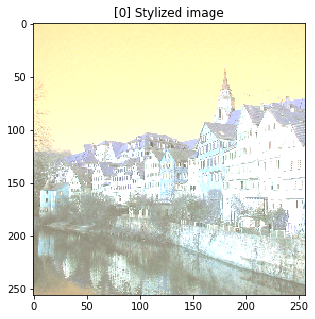

[100/10000]
1,372,650 = 392,213 + 979,050 + 1,387


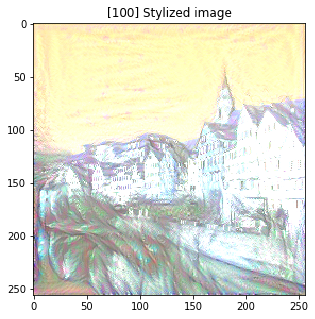

[200/10000]
1,032,219 = 387,454 + 643,403 + 1,362


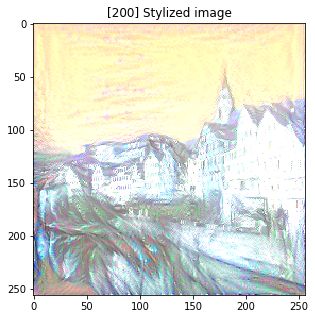

[300/10000]
874,210 = 377,212 + 495,602 + 1,396


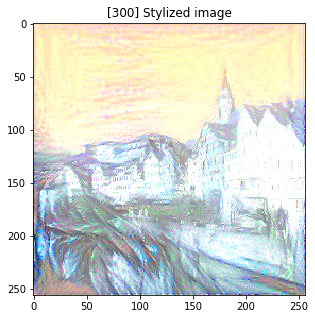

[400/10000]
777,955 = 368,050 + 408,449 + 1,456


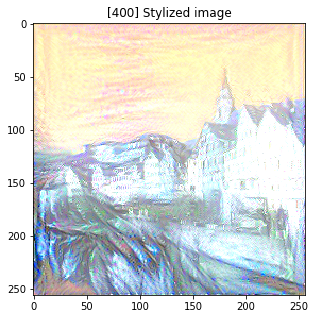

[500/10000]
712,056 = 359,655 + 350,873 + 1,528


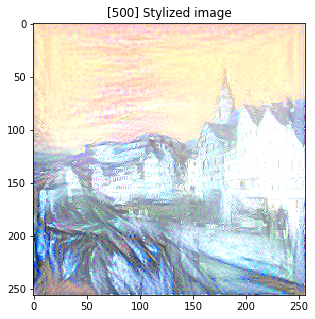

[600/10000]
663,828 = 352,686 + 309,537 + 1,605


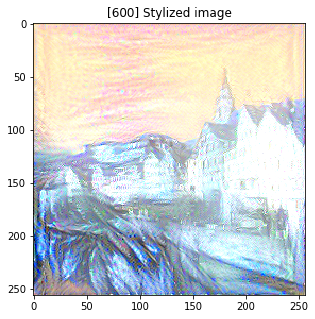

[700/10000]
626,716 = 347,193 + 277,844 + 1,679


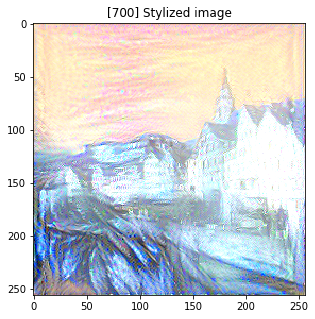

[800/10000]
597,138 = 342,085 + 253,303 + 1,750


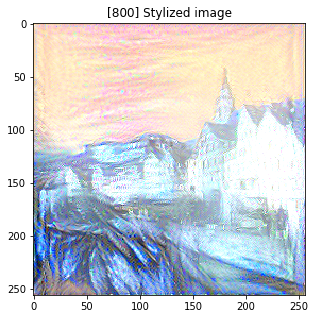

[900/10000]
572,729 = 337,509 + 233,402 + 1,818


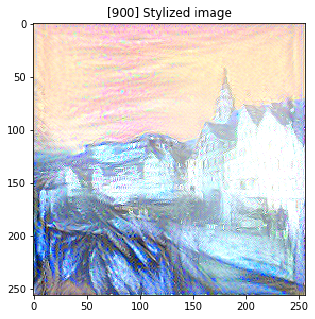

[1000/10000]
552,222 = 333,352 + 216,985 + 1,885


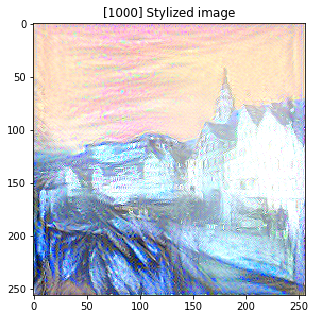

[1100/10000]
534,978 = 329,701 + 203,328 + 1,949


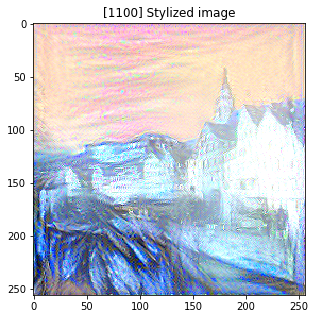

[1200/10000]
519,908 = 326,487 + 191,411 + 2,010


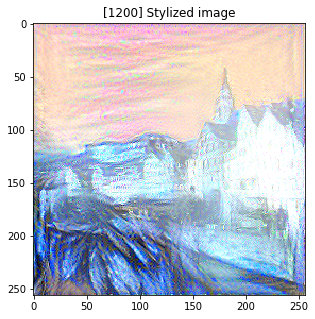

[1300/10000]
506,607 = 323,784 + 180,755 + 2,068


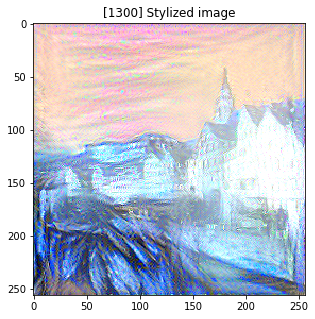

[1400/10000]
494,839 = 321,326 + 171,391 + 2,122


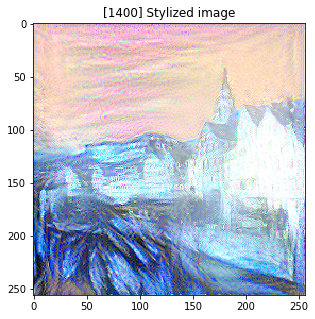

[1500/10000]
484,277 = 319,169 + 162,934 + 2,174


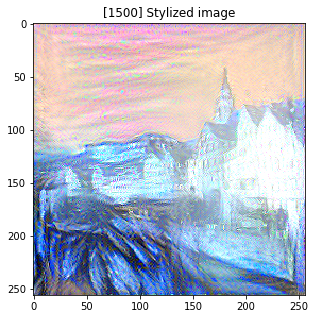

[1600/10000]
474,746 = 317,045 + 155,478 + 2,223


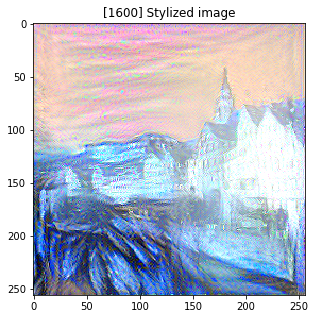

[1700/10000]
466,098 = 315,124 + 148,706 + 2,268


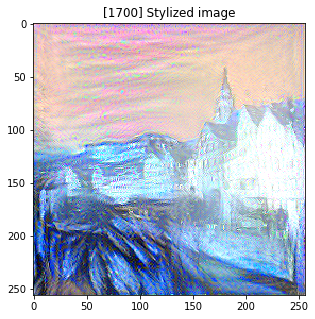

[1800/10000]
458,279 = 313,290 + 142,679 + 2,310


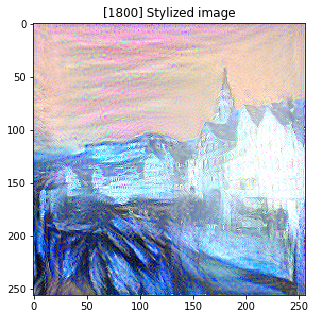

[1900/10000]
451,013 = 311,633 + 137,032 + 2,348


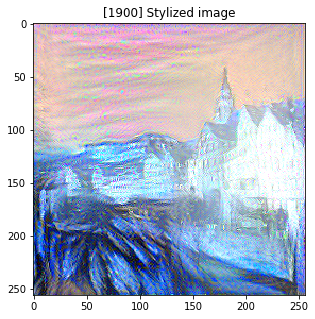

[2000/10000]
444,322 = 310,116 + 131,824 + 2,382


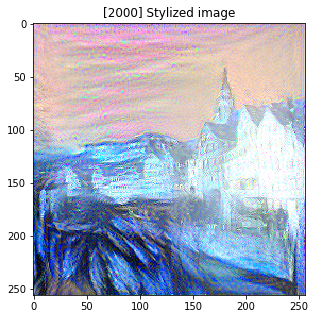

[2100/10000]
438,263 = 308,513 + 127,338 + 2,411


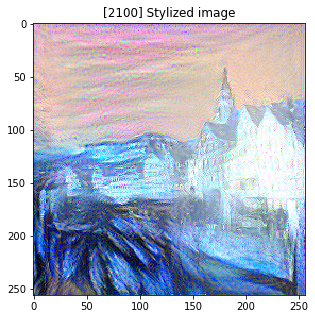

[2200/10000]
432,680 = 306,975 + 123,268 + 2,437


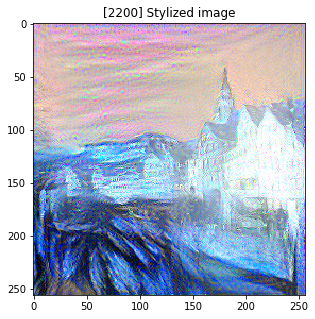

[2300/10000]
427,620 = 305,346 + 119,816 + 2,458


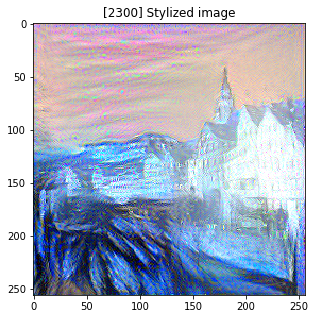

[2400/10000]
422,852 = 304,444 + 115,932 + 2,476


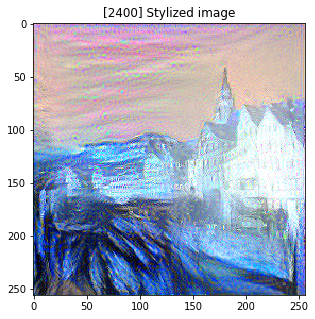

[2500/10000]
418,382 = 302,779 + 113,112 + 2,491


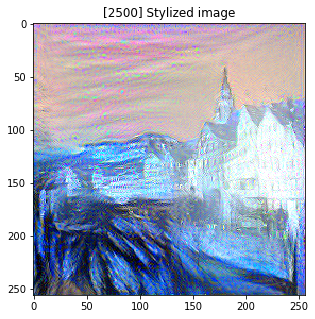

[2600/10000]
414,246 = 301,774 + 109,971 + 2,502


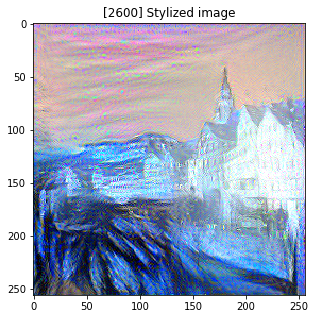

[2700/10000]
410,521 = 300,828 + 107,186 + 2,508


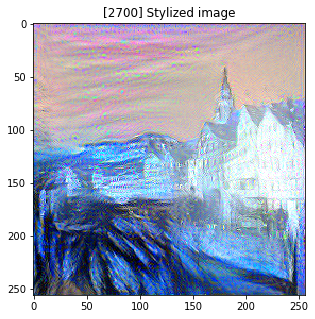

[2800/10000]
407,103 = 299,277 + 105,317 + 2,509


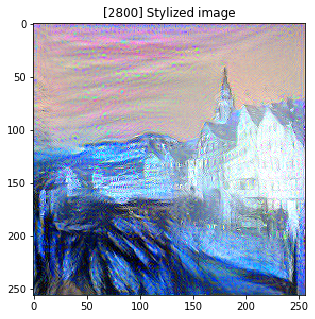

[2900/10000]
403,766 = 298,860 + 102,398 + 2,508


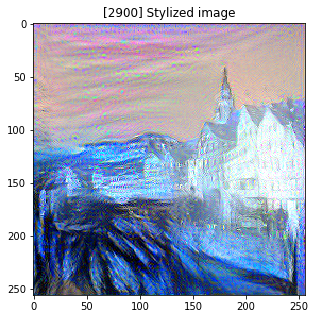

[3000/10000]
400,679 = 297,738 + 100,439 + 2,502


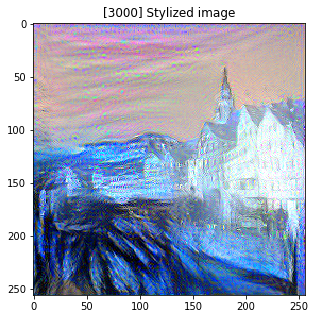

[3100/10000]
397,812 = 296,944 + 98,376 + 2,493


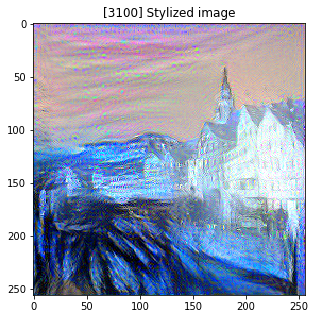

[3200/10000]
395,178 = 296,227 + 96,472 + 2,479


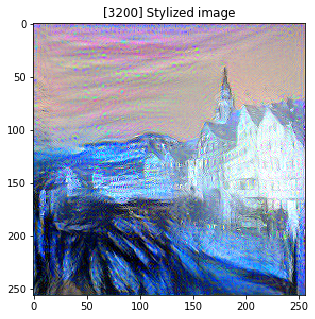

[3300/10000]
392,730 = 295,648 + 94,619 + 2,463


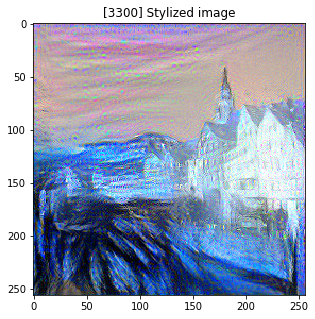

[3400/10000]
390,477 = 295,003 + 93,030 + 2,443


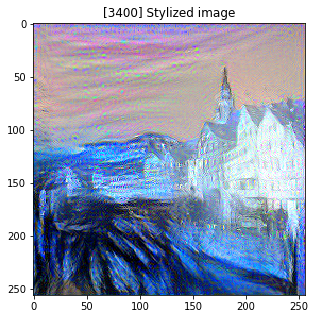

[3500/10000]
388,550 = 293,639 + 92,490 + 2,421


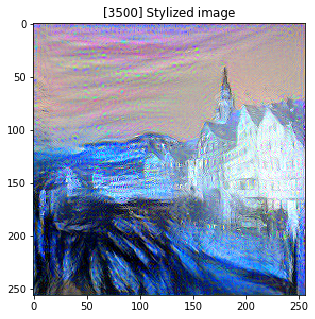

[3600/10000]
386,520 = 293,978 + 90,145 + 2,396


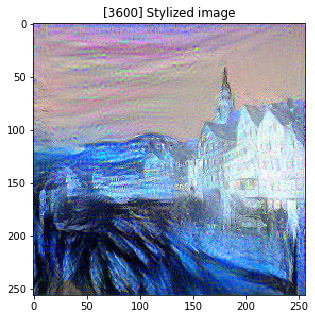

[3700/10000]
384,313 = 292,603 + 89,341 + 2,369


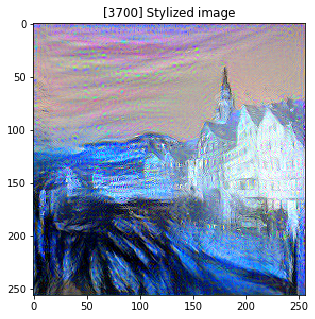

[3800/10000]
382,487 = 291,716 + 88,431 + 2,339


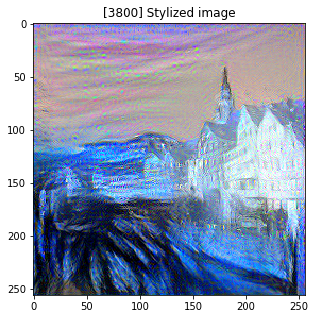

[3900/10000]
380,879 = 291,713 + 86,857 + 2,309


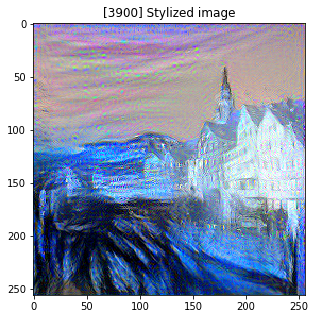

[4000/10000]
379,148 = 291,326 + 85,546 + 2,277


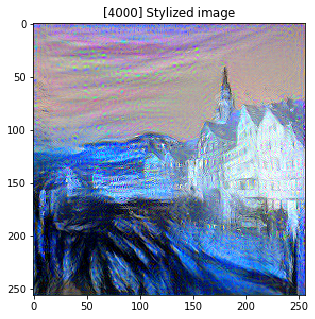

[4100/10000]
377,724 = 291,026 + 84,454 + 2,244


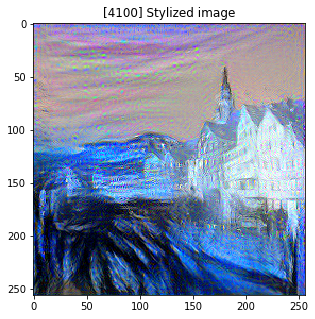

[4200/10000]
376,376 = 290,331 + 83,835 + 2,210


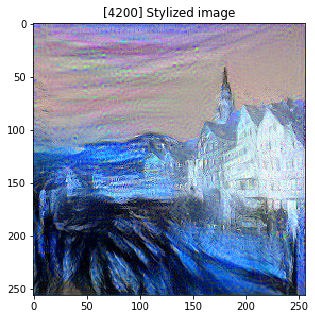

[4300/10000]
375,023 = 289,620 + 83,229 + 2,175


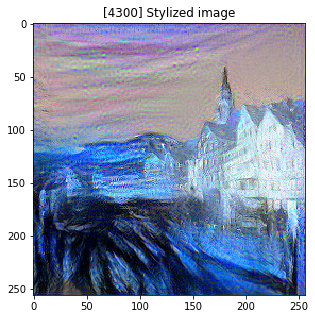

[4400/10000]
373,664 = 289,328 + 82,196 + 2,140


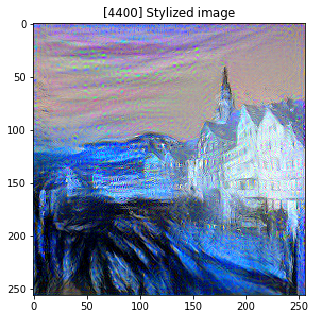

[4500/10000]
372,132 = 288,682 + 81,346 + 2,104


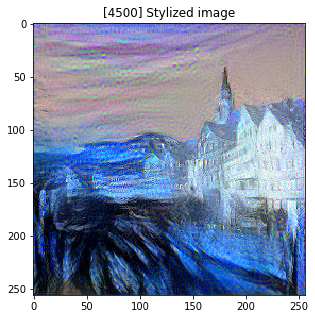

[4600/10000]
371,411 = 287,741 + 81,602 + 2,068


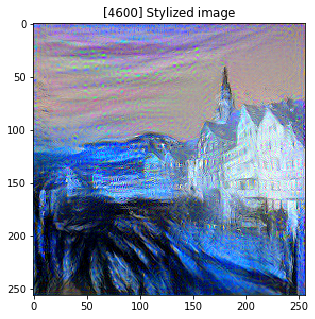

[4700/10000]
369,840 = 287,994 + 79,815 + 2,030


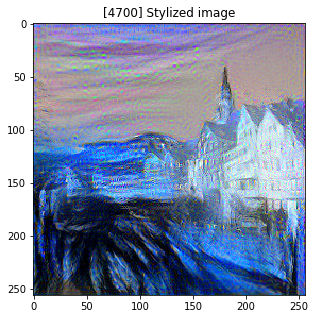

[4800/10000]
368,852 = 287,721 + 79,138 + 1,993


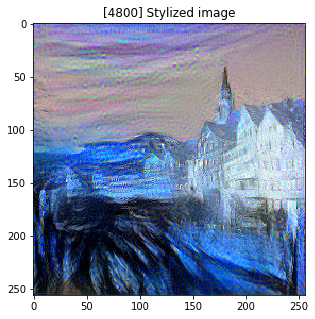

[4900/10000]
367,983 = 286,927 + 79,101 + 1,955


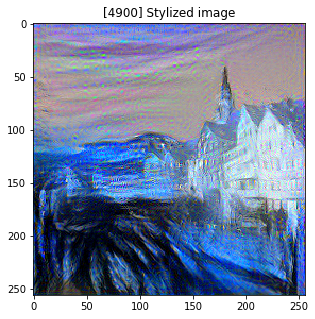

[5000/10000]
366,796 = 287,007 + 77,871 + 1,918


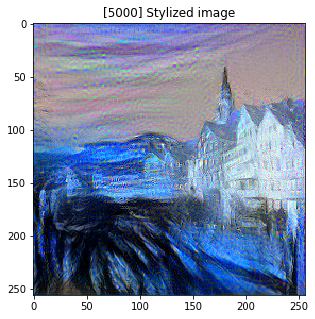

[5100/10000]
366,236 = 286,085 + 78,270 + 1,881


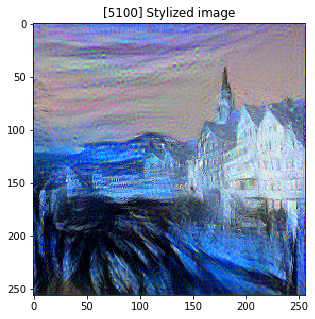

[5200/10000]
365,223 = 286,140 + 77,237 + 1,846


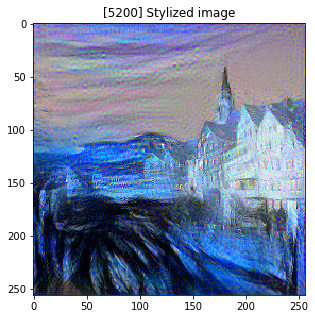

[5300/10000]
364,302 = 285,754 + 76,737 + 1,811


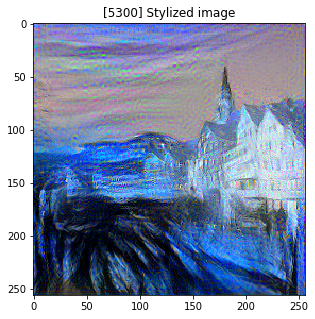

[5400/10000]
363,550 = 285,609 + 76,164 + 1,776


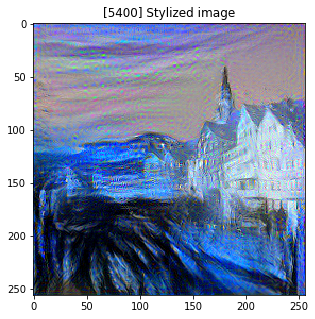

[5500/10000]
362,878 = 285,471 + 75,665 + 1,742


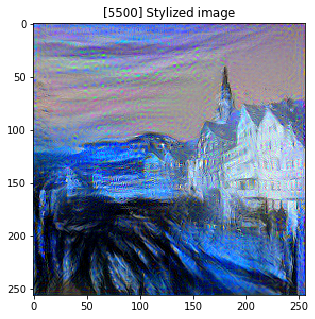

[5600/10000]
362,406 = 285,630 + 75,068 + 1,708


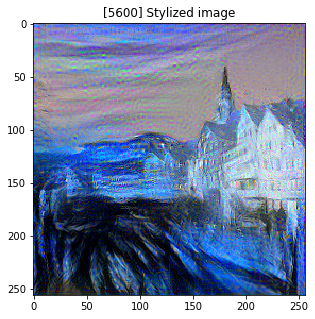

[5700/10000]
361,510 = 284,896 + 74,940 + 1,674


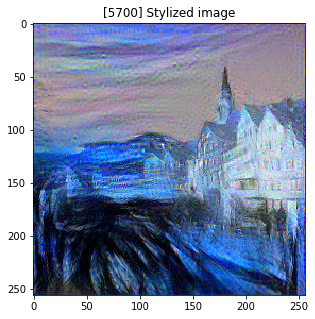

[5800/10000]
361,215 = 285,221 + 74,352 + 1,642


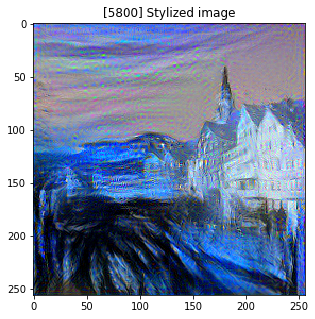

[5900/10000]
360,584 = 284,610 + 74,365 + 1,609


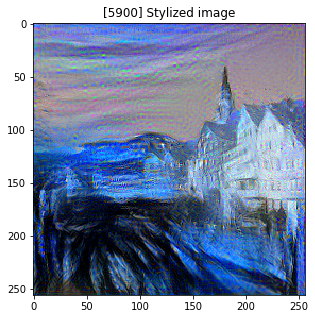

[6000/10000]
359,998 = 284,932 + 73,487 + 1,579


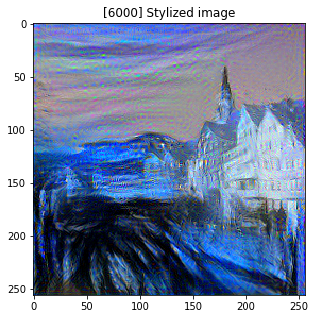

[6100/10000]
359,537 = 284,878 + 73,110 + 1,549


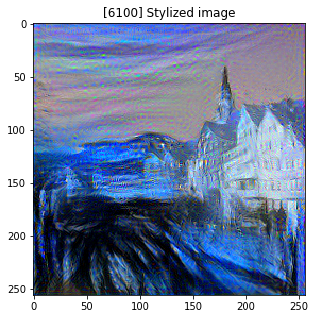

[6200/10000]
359,297 = 283,852 + 73,926 + 1,520


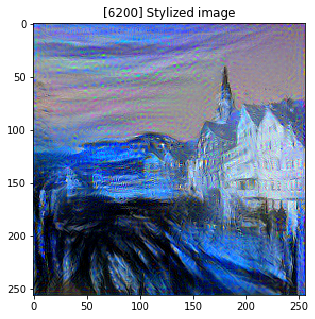

[6300/10000]
358,562 = 283,504 + 73,566 + 1,492


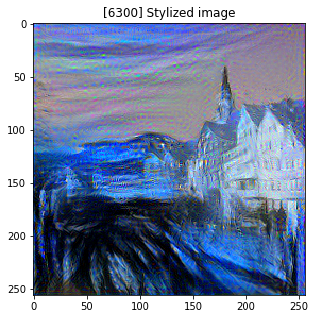

[6400/10000]
358,203 = 284,065 + 72,672 + 1,465


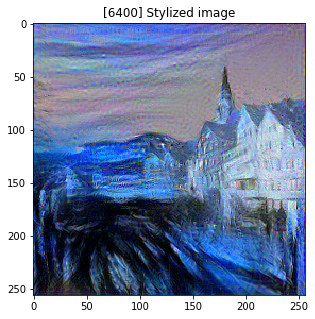

[6500/10000]
358,068 = 283,355 + 73,274 + 1,439


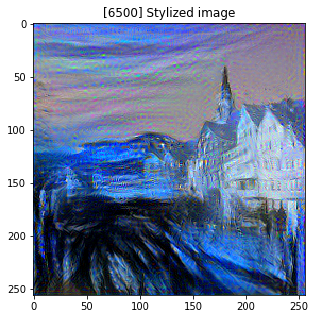

[6600/10000]
357,813 = 283,215 + 73,185 + 1,414


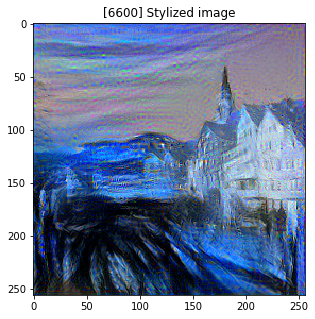

[6700/10000]
357,108 = 283,301 + 72,416 + 1,391


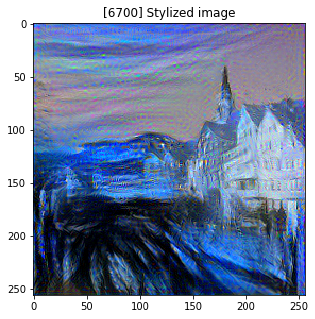

[6800/10000]
357,002 = 283,797 + 71,837 + 1,368


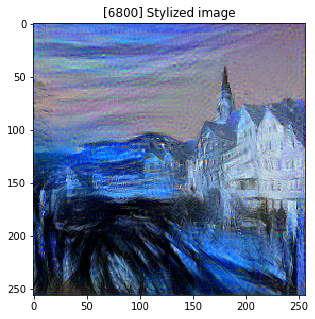

[6900/10000]
356,469 = 283,098 + 72,025 + 1,346


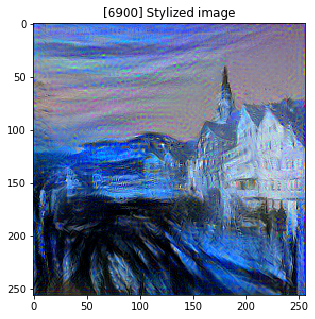

[7000/10000]
356,391 = 282,852 + 72,213 + 1,326


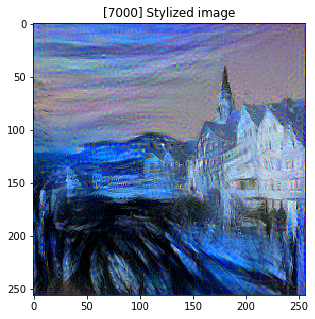

[7100/10000]
356,359 = 283,390 + 71,662 + 1,307


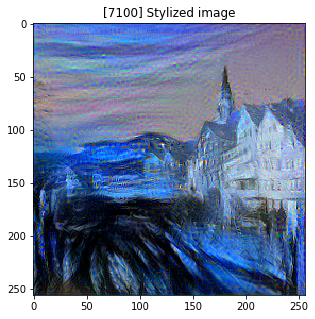

[7200/10000]
355,846 = 283,542 + 71,015 + 1,289


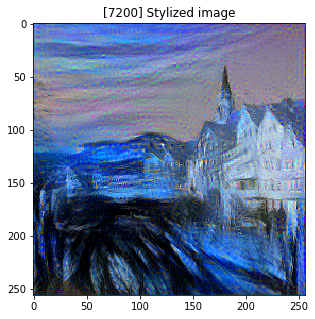

[7300/10000]
356,029 = 282,338 + 72,420 + 1,271


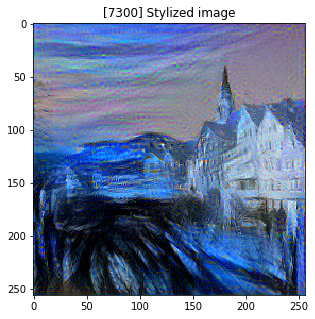

[7400/10000]
355,131 = 282,242 + 71,634 + 1,255


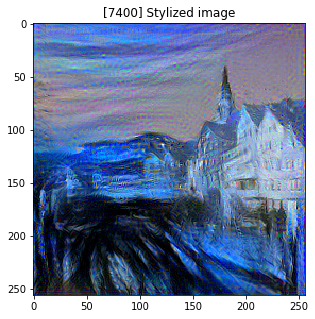

[7500/10000]
355,135 = 281,990 + 71,905 + 1,240


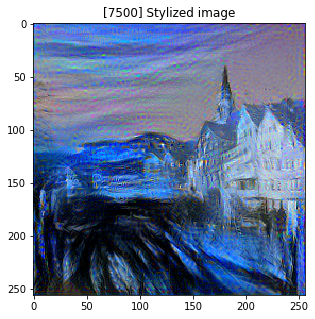

[7600/10000]
355,626 = 282,558 + 71,843 + 1,226


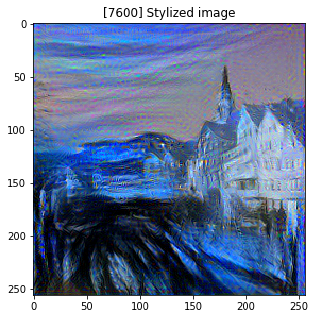

[7700/10000]
354,362 = 282,269 + 70,880 + 1,212


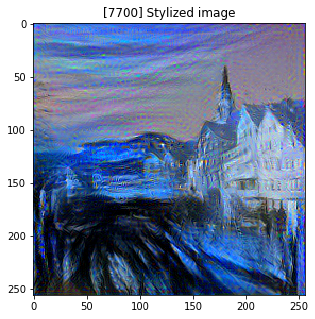

[7800/10000]
354,523 = 281,795 + 71,529 + 1,199


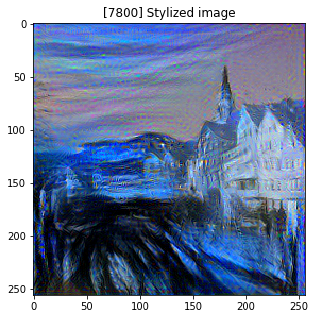

[7900/10000]
354,105 = 282,651 + 70,268 + 1,187


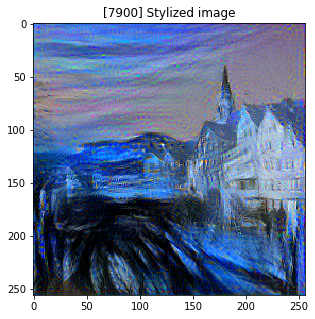

[8000/10000]
353,888 = 282,306 + 70,407 + 1,175


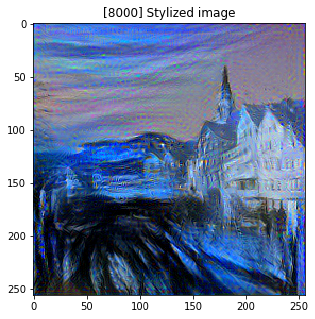

[8100/10000]
353,953 = 282,015 + 70,773 + 1,165


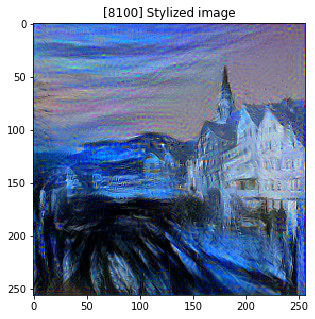

[8200/10000]
353,540 = 282,034 + 70,351 + 1,154


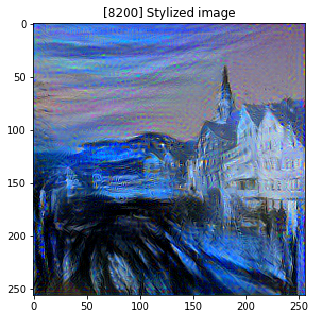

[8300/10000]
353,677 = 282,161 + 70,371 + 1,145


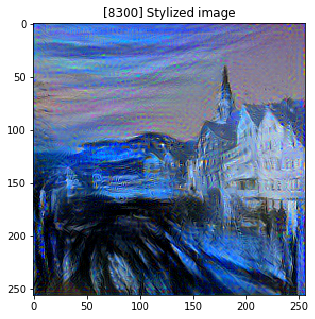

[8400/10000]
353,277 = 282,100 + 70,042 + 1,135


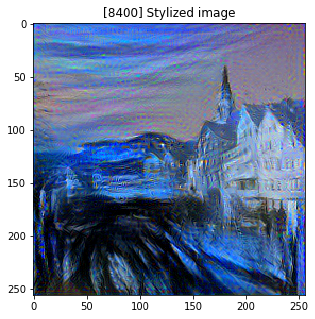

[8500/10000]
353,324 = 281,919 + 70,278 + 1,127


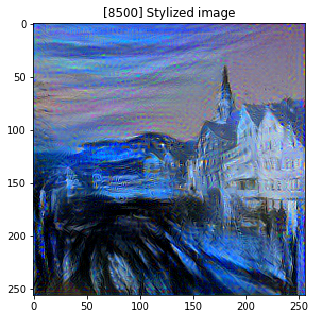

[8600/10000]
353,213 = 282,297 + 69,797 + 1,119


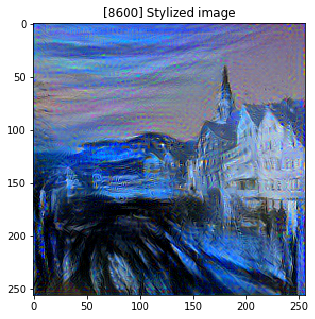

KeyboardInterrupt: 

In [33]:
# optimization (originally L-BFGS on paper)
# train_op = tf.train.AdamOptimizer(learning_rate).minimize(loss)
# train_op = tf.contrib.opt.ScipyOptimizerInterface(loss, method='L-BFGS-B')

sess.run(tf.global_variables_initializer())

max_iter = 10000

for i in range(max_iter):
    sess.run(train_op)
    if i % 100 == 0 or i == max_iter-1:
        print ("[%d/%d]" % (i, max_iter))
        out, cur_content_loss, cur_style_loss, cur_tv_loss, cur_loss = sess.run([image, content_loss, style_loss, tv_loss, loss])
        print("{:,.0f} = {:,.0f} + {:,.0f} + {:,.0f}".format(cur_loss, cur_content_loss, cur_style_loss, cur_tv_loss))
        # Plot
        stylized_img = out[0, :, :, :] + vgg.mean_pixel
        stylized_img = np.clip(stylized_img, 0, 255).astype('uint8')
        plt.figure(0, figsize=(10, 5))
        plt.imshow(stylized_img)
        plt.title("[%d] Stylized image" % (i))
        plt.show()